 # &emsp;&emsp;&emsp;&emsp;Predictive model for Seattle road accidents severity

##### This Notebook will be used to build a model able to predict the severity of a road accident given informations about road and  wheater conditions, number of persons involved and other factors 


# Introduction

##### The high rate of road accidents as a result of the increase of traffic in today's society represents an important burden in terms of human lives, as can be well deduced from the statistics that speak of about 1.35 billion people who die annually in road collisions. <br> However, over time it has been possible to notice a growing commitment by the various local authorities and bodies in the search for effective methods to contain the severity of accidents. In this regard, the Seattle authorities have collected data on road accidents over a period of time from 2004 to today. This data can be successfully used for training a machine learning model which should be able to predict the severity of the accident given the different environmental conditions.





## Data


##### The database that will be used contains several columns that report information regarding to road conditions, weather conditions, place and date of the accident as can be seen below:

In [1]:
import pandas as pd
pd.set_option('display.width', 1200, 'display.max_column', 100, 'display.max_row', 150)

In [2]:
df=pd.read_csv('C:/Users/sunny/Desktop/capstone IBM/Collisions_.csv',low_memory=False)

In [3]:
df.head(5)

,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,SERIOUSINJURIES,FATALITIES,INCDATE,INCDTTM,JUNCTIONTYPE,SDOT_COLCODE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,-122.356511,47.517361,1,327920,329420,3856094,Matched,Intersection,34911.0,17TH AVE SW AND SW ROXBURY ST,,NaN,1,Property Damage Only Collision,Angles,2,0,0,2,0,0,0,2020/01/19 00:00:00+00,1/19/2020 9:01:00 AM,At Intersection (intersection related),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,N,Clear,Dry,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
1,-122.361405,47.702064,2,46200,46200,1791736,Matched,Block,NaN,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,NaN,NaN,1,Property Damage Only Collision,Rear Ended,2,0,0,2,0,0,0,2005/04/11 00:00:00+00,4/11/2005 6:31:00 PM,Mid-Block (not related to intersection),14.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",Y,0,Raining,Wet,Dusk,NaN,5101020.0,NaN,13,From same direction - both going straight - bo...,0,0,N
2,-122.317414,47.664028,3,1212,1212,3507861,Matched,Block,NaN,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,,NaN,2,Injury Collision,Head On,2,0,0,2,1,0,0,2013/03/31 00:00:00+00,3/31/2013 2:09:00 AM,Mid-Block (not related to intersection),11.0,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,N,Clear,Dry,Dark - Street Lights On,NaN,NaN,NaN,30,From opposite direction - all others,0,0,N
3,-122.318234,47.619927,4,327909,329409,EA03026,Matched,Intersection,29054.0,11TH AVE E AND E JOHN ST,,NaN,2,Injury Collision,Pedestrian,3,1,0,1,1,0,0,2020/01/06 00:00:00+00,1/6/2020 5:55:00 PM,At Intersection (intersection related),24.0,MOTOR VEHCILE STRUCK PEDESTRIAN,NaN,N,Raining,Wet,Dark - Street Lights On,NaN,NaN,NaN,0,Vehicle going straight hits pedestrian,0,0,N
4,-122.351724,47.560306,5,104900,104900,2671936,Matched,Block,NaN,WEST MARGINAL WAY SW BETWEEN SW ALASKA ST AND ...,NaN,NaN,2,Injury Collision,Other,2,0,0,1,1,0,0,2009/12/25 00:00:00+00,12/25/2009 7:00:00 PM,Mid-Block (not related to intersection),28.0,MOTOR VEHICLE RAN OFF ROAD - HIT FIXED OBJECT,NaN,0,Clear,Ice,Dark - Street Lights On,NaN,9359012.0,Y,50,Fixed object,0,0,N


In [4]:
df.nunique()

X                   23961
Y                   23961
OBJECTID           196618
INCKEY             196618
COLDETKEY          196618
REPORTNO           196615
STATUS                  2
ADDRTYPE                3
INTKEY               7646
LOCATION            24177
EXCEPTRSNCODE           2
EXCEPTRSNDESC           1
SEVERITYCODE            2
SEVERITYDESC            2
COLLISIONTYPE          10
PERSONCOUNT            47
PEDCOUNT                7
PEDCYLCOUNT             3
VEHCOUNT               13
INJURIES               14
SERIOUSINJURIES         1
FATALITIES              1
INCDATE              6104
INCDTTM            164245
JUNCTIONTYPE            7
SDOT_COLCODE           40
SDOT_COLDESC           40
INATTENTIONIND          1
UNDERINFL               4
WEATHER                11
ROADCOND                9
LIGHTCOND               9
PEDROWNOTGRNT           1
SDOTCOLNUM         114932
SPEEDING                1
ST_COLCODE             63
ST_COLDESC             62
SEGLANEKEY           1971
CROSSWALKKEY

##### The variable to be predicted is the severity of the accident, and in the dataset it takes on two values:

In [5]:
df['SEVERITYCODE'].value_counts()

1    137776
2     58842
Name: SEVERITYCODE, dtype: int64

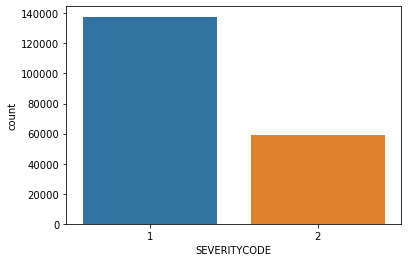

In [6]:
import seaborn as sns
sns.countplot(x='SEVERITYCODE',data=df)

##### As we can see there is a class imbalance for the target variable since there are almost twice the values equal to 1 with respect to 2 and this represents a further factor that must be taken into consideration in defining the predictive model. <br> It also appears that several columns in the dataframe represent id's keys that do not add any information to the predictive model or which contains redundant information, so that they can be dropped:

In [7]:
df.drop(labels=[ 'OBJECTID','SEVERITYDESC', 'REPORTNO', 'SDOTCOLNUM', 'INCKEY', 'COLDETKEY','SERIOUSINJURIES','FATALITIES','ST_COLCODE','SDOT_COLCODE'],axis=1,inplace=True)

#####  We can get important information from the INCDTTM column, such as the time of day (morning, evening, night) or the season in order to build additional features to incorporate into our model:

In [8]:

def date_time_columns(data):

    cc=data.copy()
    cc[['date', 'time', 'AM|PM']] = cc['INCDTTM'].str.split(' ', expand=True)
    
    cc['date'] = pd.to_datetime(cc['date'])

    cc['year'] = cc['date'].dt.year
    cc['month'] = cc['date'].dt.month
    
    cc.loc[cc[(cc['AM|PM'].isnull()) & (cc['LIGHTCOND'] == 'Dusk')].index, 'AM|PM'] = 'PM'  # dusk always PM
    cc.loc[cc[(cc['AM|PM'].isnull()) & (cc['LIGHTCOND'] == 'Dawn')].index, 'AM|PM'] = 'AM'  # dawn always AM

    cc['hours'] = pd.to_datetime(cc['time']).dt.hour  # take all hours and copy
    cc['minute'] = pd.to_datetime(cc['time']).dt.minute

    cc.loc[cc[(cc['AM|PM'] == 'PM') & (cc['hours'] != 12)].index, 'hours'] = pd.to_datetime(cc['time']).dt.hour + 12

    cc.loc[cc[(cc['AM|PM'] == 'AM') & (cc['hours'] == 12)].index, 'hours'] = 0

    cc.loc[cc[(cc['hours'] == 24)].index, 'hours'] = 0

    bins = [0, 4, 11, 16, 20, 23]
    group_name = ['Night', 'Morning', 'Afternoon', 'Evening', 'Night']
    cc['day_period'] = pd.cut(cc['hours'], bins=bins, labels=pd.Categorical(group_name), include_lowest=True)

    bins_seasons = [1, 2, 5, 8, 11, 12]
    seasons_name = ['Winter', 'Spring', 'Summer', 'Autumn', 'Winter']
    cc['Season'] = pd.cut(cc['month'], bins=bins_seasons, labels=pd.Categorical(seasons_name), include_lowest=True)

    cc.loc[cc[(cc['LIGHTCOND'] == 'Dawn') & (cc['day_period'] == 'Afternoon')].index, 'LIGHTCOND'] = 'Dusk'
    cc.loc[cc[(cc['LIGHTCOND'] == 'Dawn') & (cc['day_period'] == 'Evening')].index, 'LIGHTCOND'] = 'Dusk'
    cc.loc[cc[(cc['LIGHTCOND'] == 'Dusk') & (cc['day_period'] == 'Morning')].index, 'LIGHTCOND'] = 'Dawn'
 
    # am pm adjustment morning evening night mapping
    mapping = {'Morning': 'AM', 'Evening': 'PM', 'Afternoon': 'PM'}
    APM_null_indx = cc[cc['AM|PM'].isnull()].index
    cc.loc[APM_null_indx, 'AM|PM'] = cc.loc[APM_null_indx, 'day_period'].map(mapping)
    cc=cc.drop('INCDTTM',axis=1)
    cc=cc.drop('INCDATE',axis=1)
    return cc



In [9]:
df = date_time_columns(df)

##### We also divide the area of interest into small regions by binning the values of X and Y:

In [10]:
# X ed Y  data binning
import numpy as np
bins_x = np.linspace(min(df['X']), max(df['X']), 12)
bins_y = np.linspace(min(df['Y']), max(df['Y']), 20)
group_name_x = ['West5', 'West4', 'West3', 'West2', 'West1', 'Center', 'East1', 'East2', 'East3', 'East4', 'East5']
group_name_y = ['South9','South8','South7','South6','South5', 'South4', 'South3', 'South2', 'South1',
                'Center',
                'North1','North2','North3','North4','North5', 'North6', 'North7', 'North8','North9']
df['X_loc'] = pd.cut(df['X'], bins=bins_x, labels=group_name_x, include_lowest=True)
df['Y_loc'] = pd.cut(df['Y'], bins=bins_y, labels=group_name_y, include_lowest=True)
df['Y_loc'] = df['Y_loc'].astype(str)
df['X_loc'] = df['X_loc'].astype(str)
df['Y_loc'].loc[df['Y_loc'] == 'nan'] = np.nan
df['X_loc'].loc[df['X_loc'] == 'nan'] = np.nan
df['Ax_pos'] = df['X_loc'] + ' ' + df['Y_loc']

c:\users\sunny\pycharmprojects\pr\venv\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


In [11]:
df.head()

,X,Y,STATUS,ADDRTYPE,INTKEY,LOCATION,EXCEPTRSNCODE,EXCEPTRSNDESC,SEVERITYCODE,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,JUNCTIONTYPE,SDOT_COLDESC,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SPEEDING,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR,date,time,AM|PM,year,month,hours,minute,day_period,Season,X_loc,Y_loc,Ax_pos
0,-122.356511,47.517361,Matched,Intersection,34911.0,17TH AVE SW AND SW ROXBURY ST,,NaN,1,Angles,2,0,0,2,0,At Intersection (intersection related),"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,N,Clear,Dry,Daylight,NaN,NaN,Entering at angle,0,0,N,2020-01-19,9:01:00,AM,2020,1,9.0,1.0,Morning,Winter,West2,South8,West2 South8
1,-122.361405,47.702064,Matched,Block,NaN,HOLMAN RD NW BETWEEN 4TH AVE NW AND 3RD AVE NW,NaN,NaN,1,Rear Ended,2,0,0,2,0,Mid-Block (not related to intersection),"MOTOR VEHICLE STRUCK MOTOR VEHICLE, REAR END",Y,0,Raining,Wet,Dusk,NaN,NaN,From same direction - both going straight - bo...,0,0,N,2005-04-11,6:31:00,PM,2005,4,18.0,31.0,Evening,Spring,West2,North7,West2 North7
2,-122.317414,47.664028,Matched,Block,NaN,ROOSEVELT WAY NE BETWEEN NE 47TH ST AND NE 50T...,,NaN,2,Head On,2,0,0,2,1,Mid-Block (not related to intersection),"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",NaN,N,Clear,Dry,Dark - Street Lights On,NaN,NaN,From opposite direction - all others,0,0,N,2013-03-31,2:09:00,AM,2013,3,2.0,9.0,Night,Spring,East1,North4,East1 North4
3,-122.318234,47.619927,Matched,Intersection,29054.0,11TH AVE E AND E JOHN ST,,NaN,2,Pedestrian,3,1,0,1,1,At Intersection (intersection related),MOTOR VEHCILE STRUCK PEDESTRIAN,NaN,N,Raining,Wet,Dark - Street Lights On,NaN,NaN,Vehicle going straight hits pedestrian,0,0,N,2020-01-06,5:55:00,PM,2020,1,17.0,55.0,Evening,Winter,East1,Center,East1 Center
4,-122.351724,47.560306,Matched,Block,NaN,WEST MARGINAL WAY SW BETWEEN SW ALASKA ST AND ...,NaN,NaN,2,Other,2,0,0,1,1,Mid-Block (not related to intersection),MOTOR VEHICLE RAN OFF ROAD - HIT FIXED OBJECT,NaN,0,Clear,Ice,Dark - Street Lights On,NaN,Y,Fixed object,0,0,N,2009-12-25,7:00:00,PM,2009,12,19.0,0.0,Evening,Winter,West1,South4,West1 South4


##### Another important factor is given by the presence of null values, which in some cases represent almost the totality of the reference column

In [12]:
df.isna().sum().sort_values(ascending=False)

PEDROWNOTGRNT     191907
EXCEPTRSNDESC     190950
SPEEDING          187150
INATTENTIONIND    166807
INTKEY            130816
EXCEPTRSNCODE     109862
day_period         30363
minute             30363
hours              30363
time               30363
AM|PM              29104
JUNCTIONTYPE        6364
Ax_pos              5347
Y                   5347
Y_loc               5347
X                   5347
X_loc               5347
LIGHTCOND           5011
WEATHER             4922
ROADCOND            4846
COLLISIONTYPE       4738
ST_COLDESC          4738
UNDERINFL           4718
LOCATION            2689
ADDRTYPE            1930
HITPARKEDCAR           0
year                   0
CROSSWALKKEY           0
STATUS                 0
Season                 0
month                  0
SEVERITYCODE           0
SDOT_COLDESC           0
PERSONCOUNT            0
SEGLANEKEY             0
PEDCYLCOUNT            0
VEHCOUNT               0
INJURIES               0
date                   0
PEDCOUNT               0


##### Note how the count of null values alone would lead to an incorrect evaluation of missing values, since in many cases the cells of the dataframe contain empty spaces. Replacing the empty spaces with nan results in a more correct evaluation of the extent of the missing information:

In [13]:
import numpy as np
df = df.replace(r'^\s*$', np.NaN, regex=True)  

In [14]:
df.isna().sum().sort_values(ascending=False)

PEDROWNOTGRNT     191907
EXCEPTRSNCODE     190950
EXCEPTRSNDESC     190950
SPEEDING          187150
INATTENTIONIND    166807
INTKEY            130816
day_period         30363
minute             30363
hours              30363
time               30363
AM|PM              29104
JUNCTIONTYPE        6364
Ax_pos              5347
Y                   5347
Y_loc               5347
X                   5347
X_loc               5347
LIGHTCOND           5011
WEATHER             4922
ROADCOND            4846
COLLISIONTYPE       4738
ST_COLDESC          4738
UNDERINFL           4718
LOCATION            2689
ADDRTYPE            1930
HITPARKEDCAR           0
year                   0
CROSSWALKKEY           0
STATUS                 0
Season                 0
month                  0
SEVERITYCODE           0
SDOT_COLDESC           0
PERSONCOUNT            0
SEGLANEKEY             0
PEDCYLCOUNT            0
VEHCOUNT               0
INJURIES               0
date                   0
PEDCOUNT               0


##### Once the columns having most missing values ('EXCEPTRSNCODE', 'EXCEPTRSNDESC') are deleted and columns having binary values are corrected with the right type of data as below, we finally get the cleaned up dataframe that will be used for the model we are going to build:

In [15]:
# binary clear class imputation
df['INATTENTIONIND'].replace([np.nan, 'Y'], ['N', 'Y'], inplace=True)  #
df['UNDERINFL'].replace(['N', 'Y', '0', '1'], ['N', 'Y', 'N', 'Y'], inplace=True) 
df['PEDROWNOTGRNT'].replace([np.nan, 'Y'], ['Missing', 'Y'], inplace=True)  #
df['SPEEDING'].replace([np.nan, 'Y'], ['N', 'Y'], inplace=True)  #

df.drop(['INTKEY','EXCEPTRSNCODE','EXCEPTRSNDESC','INATTENTIONIND','PEDROWNOTGRNT','SPEEDING'],axis=1,inplace=True)
df.dropna(inplace=True)

In [16]:
df.isna().sum().sort_values(ascending=False)

Ax_pos           0
PEDCOUNT         0
UNDERINFL        0
SDOT_COLDESC     0
JUNCTIONTYPE     0
INJURIES         0
VEHCOUNT         0
PEDCYLCOUNT      0
PERSONCOUNT      0
Y_loc            0
COLLISIONTYPE    0
SEVERITYCODE     0
LOCATION         0
ADDRTYPE         0
STATUS           0
Y                0
WEATHER          0
ROADCOND         0
LIGHTCOND        0
ST_COLDESC       0
SEGLANEKEY       0
CROSSWALKKEY     0
HITPARKEDCAR     0
date             0
time             0
AM|PM            0
year             0
month            0
hours            0
minute           0
day_period       0
Season           0
X_loc            0
X                0
dtype: int64

##### The dimensions of the training set are:

In [17]:
df.shape

(157460, 34)

##### We can now see the distribution of type 1 and type 2 accidents:

In [18]:
import folium
from folium import plugins
import matplotlib.pyplot as plt

def map_f(df,Severity_group,init_date,end_date):
    severity_group=Severity_group
    df_sev=df.groupby('SEVERITYCODE')
    df_incidents = df_sev.get_group(severity_group)[['X', 'Y', 'date', 'SEVERITYCODE', 'LOCATION']]
    df_incidents.dropna(inplace=True)
    df_incidents.sort_values(by='date', ascending=False, inplace=True)

    # df_incidents=df_incidents[df_incidents.date.isin(['2020-05-20','2020-03-20'])]
    df_incidents = df_incidents.set_index('date').loc[init_date:end_date, :]
    df_incidents.reset_index(inplace=True)

    A_map = folium.Map(location=[47.621058,-122.32],zoom_start=10)
    incidents = folium.map.FeatureGroup()
    incidents = plugins.MarkerCluster().add_to(A_map)


    for i, j, k in zip(df_incidents.Y, df_incidents.X, df.date):
        incidents.add_child(folium.CircleMarker(
            [i, j],
            radius=5,
            color='red',
            fill=True,
            popup='Y='+str(i)+' X='+str(j),
            fill_color='red',
            fill_opacity=1))


    data_heatmap = df_incidents[['Y','X']].copy()
    data_heatmap = [[row['Y'], row['X']] for index, row in data_heatmap.iterrows()]
    plugins.HeatMap(data_heatmap, radius=10).add_to(A_map)
    #A_map.add_child(incidents)
    #A_map.save(filename)
    display(A_map)
    



##### For example, the distribution of incidents with severity code equal to 1 for the period from January 1, 2018 to January 1, 2020 is represented below: 

In [19]:
map_f(df,1,'2020-01-01','2018-01-01')

#### The distribution of incidents with severity code equal to 2 for the period from 1 January 2018 to 1 January 2020 is instead shown below:

In [20]:
map_f(df,2,'2020-01-01','2018-01-01')

##### As you can see, in both cases the accidents tend to gather in the central part

## Methodology

##### As for the construction of the model after having appropriately transformed our dataset, we will try to test a dozen basic classification models. Having chosen one of the best performing we will proceed to the tuning of the hyperparameters through the Bayessian research method in order to reach the highest accuracy that can be reached with the dataframe we have.

##### First we proceed to divide the dataset into train and test set, we will use about 25000 values ​​to test the model

In [348]:
from sklearn.model_selection import train_test_split
x=df.drop('SEVERITYCODE',axis=1)
y=df['SEVERITYCODE']
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.15,random_state=1)

In [349]:
x_train.drop(['X','Y'],axis=1,inplace=True)
x_test.drop(['X','Y'],axis=1,inplace=True)
print(x_train.shape,len(y_train))
print(x_test.shape,len(y_test))

(133841, 31) 133841
(23619, 31) 23619


c:\users\sunny\pycharmprojects\pr\venv\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [350]:
x_train.head()

,STATUS,ADDRTYPE,LOCATION,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,JUNCTIONTYPE,SDOT_COLDESC,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR,date,time,AM|PM,year,month,hours,minute,day_period,Season,X_loc,Y_loc,Ax_pos
42914,Matched,Intersection,5TH AVE AND PIKE ST,Angles,6,0,0,3,2,At Intersection (intersection related),"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",Y,Clear,Dry,Dark - Street Lights On,Entering at angle,0,0,N,2006-08-19,9:14:00,PM,2006,8,21.0,14.0,Night,Summer,Center,Center,Center Center
152576,Matched,Block,35TH AVE SW BETWEEN SW BARTON ST AND SW CAMBRI...,Angles,2,0,0,2,0,Mid-Block (not related to intersection),NOT ENOUGH INFORMATION / NOT APPLICABLE,N,Clear,Dry,Daylight,Entering at angle,0,0,N,2016-02-22,5:47:00,PM,2016,2,17.0,47.0,Evening,Winter,West3,South8,West3 South8
91186,Matched,Block,AIRPORT WAY S BETWEEN S EDMUNDS ST AND AIRPORT...,Left Turn,2,0,0,2,0,Mid-Block (not related to intersection),"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",N,Clear,Dry,Daylight,From opposite direction - one left turn - one ...,0,0,N,2010-11-02,4:25:00,PM,2010,11,16.0,25.0,Afternoon,Autumn,Center,South4,Center South4
110509,Matched,Block,15TH AVE W BETWEEN W NEWTON ST AND W ARMORY WAY,Other,2,0,0,2,0,Driveway Junction,"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",N,Clear,Dry,Daylight,From same direction - all others,0,0,N,2012-01-12,12:00:00,PM,2012,1,12.0,0.0,Afternoon,Winter,West3,North2,West3 North2
191511,Matched,Block,DIAGONAL AVE S BETWEEN 4TH AVE S AND DEAD END 3,Parked Car,2,0,0,2,0,Mid-Block (not related to intersection),"MOTOR VEHICLE STRUCK MOTOR VEHICLE, FRONT END ...",N,Overcast,Dry,Daylight,One parked--one moving,0,0,N,2019-04-11,11:48:00,AM,2019,4,11.0,48.0,Morning,Spring,Center,South4,Center South4


##### The columns 'STATUS', 'ADDRTYPE', 'LOCATION', 'COLLISIONTYPE', 'JUNCTIONTYPE', 'SDOT_COLDESC', 'UNDERINFL', 'WEATHER', 'ROADCOND', 'LIGHTCOND', 'ST_COLDESC', 'HITPARKEDCAR', 'date', 'time', 'AM | PM', 'day_period', 'Season', 'X_loc', 'Y_loc', 'Ax_pos' appear to contain categorical and non-numeric values which is why we can label encode them as an initial approach, in order not to disproportionately increase the dimensionality of the problem through one hot encoding and fall into the curse of dimensionality.

In [351]:
from sklearn.preprocessing import LabelEncoder

categorical_columns=['STATUS', 'ADDRTYPE', 'LOCATION', 'COLLISIONTYPE', 
                     'JUNCTIONTYPE', 'SDOT_COLDESC', 'UNDERINFL', 'WEATHER', 
                     'ROADCOND', 'LIGHTCOND', 'ST_COLDESC', 'HITPARKEDCAR', 
                     'date','time', 'AM|PM', 'day_period', 'Season', 'X_loc', 
                     'Y_loc', 'Ax_pos']
Encoder=LabelEncoder()

for i in categorical_columns:
    x_train[i]=Encoder.fit_transform(x_train[i])
    x_test[i]=Encoder.fit_transform(x_test[i])


c:\users\sunny\pycharmprojects\pr\venv\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
c:\users\sunny\pycharmprojects\pr\venv\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':


In [352]:
x_train.head()

,STATUS,ADDRTYPE,LOCATION,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,INJURIES,JUNCTIONTYPE,SDOT_COLDESC,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR,date,time,AM|PM,year,month,hours,minute,day_period,Season,X_loc,Y_loc,Ax_pos
42914,0,1,7700,0,6,0,0,3,2,1,14,1,1,0,2,4,0,0,0,674,674,1,2006,8,21.0,14.0,3,2,0,0,0
152576,0,0,5380,0,2,0,0,2,0,4,26,0,1,0,5,4,0,0,0,3824,467,1,2016,2,17.0,47.0,1,3,8,17,135
91186,0,0,9071,3,2,0,0,2,0,4,14,0,1,0,5,11,0,0,0,1887,385,1,2010,11,16.0,25.0,0,0,0,13,13
110509,0,0,1327,4,2,0,0,2,0,2,14,0,1,0,5,14,0,0,0,2322,120,1,2012,1,12.0,0.0,0,3,8,2,121
191511,0,0,10983,5,2,0,0,2,0,4,14,0,4,0,5,27,0,0,0,4968,108,0,2019,4,11.0,48.0,2,1,0,13,13


##### Once the encoding has been carried out, the values ​​can be scaled:

In [335]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
columns = x_train.columns
x_train_scaled = scaler.fit_transform(x_train)
x_train_scaled = pd.DataFrame(x_train, columns=columns)
x_test_scaled = scaler.fit_transform(x_test)
x_test_scaled = pd.DataFrame(x_test, columns=columns)

In [353]:
x_test=x_test.drop(['INJURIES'],axis=1)#drop as it is directly related to severity code using injuries give 100% accuracy
x_train=x_train.drop(['INJURIES'],axis=1)
x_test_scaled=x_test.drop(['INJURIES'],axis=1)#drop as it is directly related to severity code using injuries give 100% accuracy
x_train_scaled=x_train.drop(['INJURIES'],axis=1)

##### Now let's try 12 classification models from the sklearn library

In [269]:
import pandas as pd
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, recall_score, precision_score, balanced_accuracy_score, confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.naive_bayes import GaussianNB
from catboost import CatBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import BaggingClassifier, GradientBoostingClassifier,HistGradientBoostingClassifier
from sklearn.linear_model.ridge import RidgeClassifier



C1=LogisticRegression(max_iter=3000)
C2=DecisionTreeClassifier()
C3=XGBClassifier()
C4 =CatBoostClassifier(verbose=0)
C5=RidgeClassifier()
C6=HistGradientBoostingClassifier()
C7=GradientBoostingClassifier()
C8=BaggingClassifier()
C9= GaussianNB()
C10 = AdaBoostClassifier()
C11 = MLPClassifier()
C12 = RandomForestClassifier()

classifiers = [C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12]
Cls_names=['LogisticRegression','DecisionTreeClassifier','XGBClassifier','CatBoostClassifier',
           'RidgeClassifier','HistGradientBoostingClassifier','GradientBoostingClassifier','BaggingClassifier',
           'GaussianNB','AdaBoostClassifier','MLPClassifier','RandomForestClassifier']

clfs_table={}
for i,j in zip(classifiers,Cls_names):
    scores = cross_val_score(i, x_train_scaled, y_train_scaled, cv=3, scoring='balanced_accuracy', n_jobs=-1)
    i.fit(x_train_scaled,y_train_scaled)
    
    y_hat=i.predict(x_test_scaled)
    mean_score_train=scores.mean()*100
    balanced_accuracy_score_test=balanced_accuracy_score(y_test_scaled, y_hat)*100
    precision_score_test=precision_score(y_test_scaled, y_hat)*100
    recall_test=recall_score(y_test_scaled, y_hat)*100
    overall_accuracy=accuracy_score(y_test_scaled, y_hat)*100
    print("\t\t\t\tModel: ",j,'\n')
    print('Mean balanced accuracy cross validation: %0.2f' % (mean_score_train))
    print('Balanced Accuracy score on test set: %0.2f' % (balanced_accuracy_score_test))
    print('Precision score on test set: %0.2f' % (precision_score_test))
    print('Recall test set: %0.2f' % (recall_test))
    print('Overall accuracy on test set: %0.2f' % (overall_accuracy))
    print('Confusion Matrix:\n',confusion_matrix(y_test_scaled, y_hat),'\n')
    clfs_table[j]=[balanced_accuracy_score_test,precision_score_test,recall_test,overall_accuracy,mean_score_train]
    
clfs_table=pd.DataFrame.from_dict(clfs_table)
clfs_table.index=['Balanced accuracy','Precision','Recall','Overall accuracy','Balanced accuracy trainset']


				Model:  LogisticRegression 

Mean balanced accuracy cross validation: 61.54
Balanced Accuracy score on test set: 61.47
Precision score on test set: 74.35
Recall test set: 95.48
Overall accuracy on test set: 74.24
Confusion Matrix:
 [[15510   734]
 [ 5350  2025]] 

				Model:  DecisionTreeClassifier 

Mean balanced accuracy cross validation: 62.63
Balanced Accuracy score on test set: 61.52
Precision score on test set: 75.79
Recall test set: 77.71
Overall accuracy on test set: 67.60
Confusion Matrix:
 [[12623  3621]
 [ 4032  3343]] 

				Model:  XGBClassifier 

Mean balanced accuracy cross validation: 65.34
Balanced Accuracy score on test set: 62.81
Precision score on test set: 75.17
Recall test set: 94.07
Overall accuracy on test set: 74.55
Confusion Matrix:
 [[15280   964]
 [ 5048  2327]] 

				Model:  CatBoostClassifier 

Mean balanced accuracy cross validation: 65.56
Balanced Accuracy score on test set: 63.89
Precision score on test set: 75.79
Recall test set: 93.75
Overall accur

##### As we can see the results are not very satisfactory, we have FP values that are always higher than TN and this is mainly due to the fact that we have an imbalanced data. In order to obtain a model that can take into account the imbalance of the data we proceed at first instance with the tuning of the hyperparameters of one of the best performing model.<br> We choose XGBoost as one of the most famous and used models and we analyze the accuracy values that can be achieved by tuning its hyperparameters. <br> Bayesian reseach will be used for the tuning:

In [355]:
from sklearn.metrics import accuracy_score, confusion_matrix, plot_confusion_matrix
from sklearn.metrics import balanced_accuracy_score, recall_score, precision_score, f1_score, jaccard_score
from sklearn.model_selection import RepeatedStratifiedKFold
import xgboost as xgb
import matplotlib.pyplot as plt
from skopt import BayesSearchCV
from skopt.space import Real, Categorical, Integer
pd.set_option('display.width', 12200, 'display.max_column', 1300, 'display.max_row', 150)

#Hyperparameter space XGB
Search_spaces_XGB = {
    "scale_pos_weight": Real(2.2, 2.35),
    'learning_rate': Real(0.4,0.6),
     'min_child_weight': Real(0,5),
     'gamma': Real(0, 2),
     'max_depth': Integer(3, 15),
     'subsample': Real(0.50, 1),
     'colsample_bytree': Real(0.1, 1.0),
     'colsample_bylevel': Real(0.1, 1.0),
     'reg_lambda': Real(1e-6, 10000),
     'reg_alpha': Real(0.000001, 1),
     'n_estimators': Integer(100, 200),
     'base_score':Real(0.5,0.6),
}
n_iteration=1

bayes_cv_tuner = BayesSearchCV(
    estimator=xgb.XGBClassifier(tree_method='hist',eval_metric='map',
                                objective= 'binary:logistic'),
                                search_spaces=Search_spaces_XGB,
                                scoring='balanced_accuracy',
                                cv=RepeatedStratifiedKFold(n_splits=5, n_repeats=2, random_state=14),
                                n_jobs=-1,
                                n_iter=n_iteration,
                                verbose=0,
                                refit=True,
                                random_state=42)


def status_print(optim_result):
    """Status callback durring bayesian hyperparameter search"""

    # Get all the models tested so far in DataFrame format
    all_models = pd.DataFrame(bayes_cv_tuner.cv_results_)


    best_params = pd.Series(bayes_cv_tuner.best_params_)
    print('Model #{}\nBest Score: {}\n'.format(
        len(all_models),
        np.round(bayes_cv_tuner.best_score_, 3)))
    
def Xgb_classify(X,y,X_testset,y_testset):
    
    print('\nXGBOOST:\n\n')
    
    Bayes_ = bayes_cv_tuner.fit(X, y, callback=status_print)
    
 
    classifier = Bayes_.best_estimator_
    
    print('\nbest estimator:\n', Bayes_.best_params_, '\n')
    
    preds = classifier.predict(X_testset)
    Con_M = confusion_matrix(y_testset, preds, labels=[1, 2])

    T_1 = Con_M[0, 0]
    F_2 = Con_M[0, 1]
    F_1 = Con_M[1, 0]
    T_2 = Con_M[1, 1]
    Perc_1 = T_1 * 100 / (T_1 + F_2)
    Perc_2 = T_2 * 100 / (T_2 + F_1)
    print('Confusion Matrix:\n',Con_M, '\n')
    print('Test set value distribuition:\n', y_testset.value_counts(), '\n')
    XGB_table={'Balanced_accuracy':balanced_accuracy_score(y_testset, preds)*100,
              'Recall':recall_score(y_testset, preds)*100,
              'Precision':precision_score(y_testset, preds)*100,
              'Overall accuracy':accuracy_score(y_testset, preds)*100,
              'F1 score':f1_score(y_testset, preds)*100,
              'Severity 1 right prediction %':round(Perc_1, 2),
              'Severity 2 right prediction %':round(Perc_2),
               'Jaccard Score':jaccard_score(y_testset, preds)*100,
              }
    XGB_table=pd.DataFrame.from_dict(XGB_table,orient='index',columns=['XGBoost tuned Classifier'])
    return XGB_table,classifier.get_xgb_params()

    
XGB_tuning_results,best_params=Xgb_classify(x_train,y_train,x_test,y_test)



XGBOOST:


Model #1
Best Score: 0.715


best estimator:
 OrderedDict([('base_score', 0.5410103958853314), ('colsample_bylevel', 0.7549531688595925), ('colsample_bytree', 0.9395811989630505), ('gamma', 0.6315991869740974), ('learning_rate', 0.5340295896537869), ('max_depth', 8), ('min_child_weight', 1.7546566744957202), ('n_estimators', 174), ('reg_alpha', 0.3044640065731951), ('reg_lambda', 6477.915883820985), ('scale_pos_weight', 2.2824945912714676), ('subsample', 0.5634169091979253)]) 

Confusion Matrix:
 [[11357  4887]
 [ 2183  5192]] 

Test set value distribuition:
 1    16244
2     7375
Name: SEVERITYCODE, dtype: int64 



## Results

##### As for the basic classifiers we can see from the following table how the best results on the basis of the values of balanced accuracy and overall accuracy are provided by the classifiers CatBoost, XGBoost, RandomForest and the Neural Network.

In [356]:
clfs_table

,LogisticRegression,DecisionTreeClassifier,XGBClassifier,CatBoostClassifier,RidgeClassifier,HistGradientBoostingClassifier,GradientBoostingClassifier,BaggingClassifier,GaussianNB,AdaBoostClassifier,MLPClassifier,RandomForestClassifier
Balanced accuracy,61.469518,61.518753,62.809022,63.889641,60.410236,63.238238,62.329526,62.540867,59.562887,62.534955,64.910137,63.495065
Precision,74.352828,75.791054,75.167257,75.787588,73.701889,75.353941,74.834084,75.252011,73.232254,75.043131,76.732074,75.636528
Recall,95.481409,77.708692,94.065501,93.745383,97.254371,94.693425,95.099729,90.993598,98.122384,93.720758,89.793154,92.901995
Overall accuracy,74.241077,67.598120,74.545916,75.100555,74.245311,75.049748,74.634828,73.224946,74.042085,74.245311,74.253779,74.537449
Balanced accuracy trainset,61.542498,62.631495,65.341438,65.557286,60.610572,64.717661,64.381912,63.997907,59.868356,65.031269,64.869096,65.057598


##### As expected, however, the tuning of the hyperparameters of the XGBoost classifier allows to obtain the best results as follows: <br><br> NB: we start from a balanced accuracy value of 62.81% and overall accuracy of 74.55%

values distribuition in test set:
 1    16244
2     7375
Name: SEVERITYCODE, dtype: int64


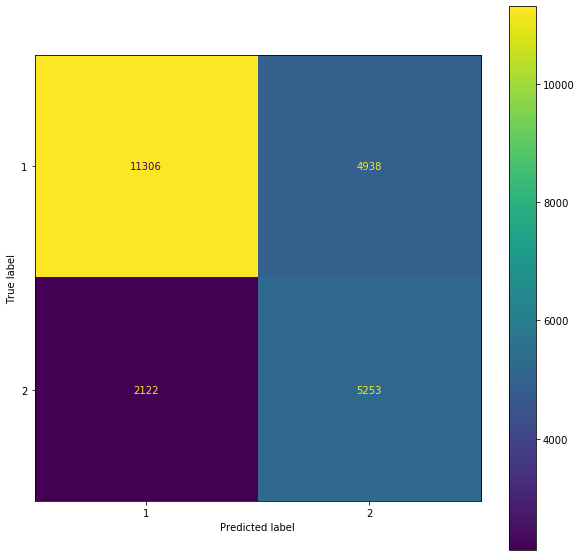

,XGBoost tuned Classifier
Balanced_accuracy,70.157523
Recall,69.915046
Precision,83.877400
Overall accuracy,70.066472
F1 score,76.262423
Severity 1 right prediction %,69.920000
Severity 2 right prediction %,70.000000
Jaccard Score,61.632387


In [357]:
tuned_XGB=XGBClassifier(**best_params)
tuned_XGB.fit(x_train,y_train)
print('values distribuition in test set:\n',y_test.value_counts())
fig, ax = plt.subplots(figsize=(10, 10))
plot_confusion_matrix(tuned_XGB, x_test, y_test,ax=ax)
plt.show()
XGB_tuning_results

##### As shown by the table after tuning the balanced accuracy increased from 62,81% to 70,15% while losing n 4,49% on overall accuracy from 74,55% to 70,06 , which is quite normal as we tuned the hyperparameters to optimize the balanced accuracy, so that both classes would be classified with same accuracy.

## Conclusions

##### In conclusion, we can see that the model created allows to classify the severity of an accident in an acceptable way on the basis of the information contained in the initial dataframe. <br> It should be noted, however, that there is still a large margin of choice for the methodologies that can be used in each phase of the entire classification process pipeline. <br> For example, missing value imputation methods such as KNN or MICE can be implemented to impute missing values instead of dropping them. <br> Target encoding can be used instead of just label encoding the columns, and in general perform a better feature engineering to get the most out of the different features. <br> It is also possible to implement the SMOTE method for oversampling the minority class or the dowsampling of the majority class. <br> Further increase in balanced and overall accuracy could be obtained by tuning the parameters of the CatBoost classifier or of the neural network. <br> Finally, the results could be compared by implementing a superlearner with all the basic models. <br>